# Anime Face Generation
In the final project, you'll learn to define and train a GAN on a dataset of anime faces. The goal is to obtain a generator network to generate images of anime faces that look very cute and cartoon!

The final project includes several tasks, from loading data and training a GAN. At the end of the notebook, you will be able to visualize the results of the trained generator to understand its performance; the samples you generate should look like fairly anime faces with a small amount of noise.

**In this project, we encourage students to think about how to improve the performance of GAN and the stability of training. Students can write the experimental results and analysis into the report. This part will be used as a bonus item.**

## Download the data
You can use this link [Anime Face dataset](https://www.kaggle.com/lunarwhite/anime-face-dataset-ntumlds) to download dataset for training your adversarial networks.

This is an dataset consisting of 36.7k high-quality anime faces. We suggest that you utilize a GPU for training.

In [1]:
#import necessary libraries
import torch, torchvision
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch import nn, optim
from torchvision.utils import make_grid
from torchvision.utils import save_image
from tqdm.notebook import tqdm
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
from PIL import Image
%matplotlib inline
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
#TODO: define your own dataset address"
root = 'images'

## Visualize the input image
Note that these are color images with 3 color channels (RGB) each.

In [2]:
# Disabled to enable running the notebook from top down
#for images in trainloader:
#    show_images(images)
#    break

## Pre-process and Load the Data
Based on the previous knowledge, students are required to complete the code for preprocessing and data loading. 
### For preprocessing 
we recommend students to use `transforms` in `torchvision`. Students are required to fill in at least two items: `Resize` and `CenterCrop`. Students can also try other **data augumentation methods** and display the results in the final report as a **bonus item**.
### Load the Data
In this part, you need define your own `Dataset` to load training images. For GAN, you don't need to load label data. Thus, defining the Dataset is easier than previous assignments.

In [3]:
#TODO: Create your own Preprocessing methods
#The batch_size is defined by yourself based on the memory of GPU or CPU.
batch_size = 96
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
transform = transforms.Compose([transforms.CenterCrop(60),
                                transforms.Resize(64),
                                transforms.ToTensor(),
                                transforms.Normalize(*stats)])
num_workers = 0

def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]
# Loading data including Dataset and Dataloader.
class AnimeData(Dataset):
    """
    Wrap the data into a Dataset class, and then pass it to the DataLoader
    :__init__: Initialization data
    :__getitem__: support the indexing such that dataset[i] can be used to get ith sample
    :__len__: return the size of the dataset.
    """
    def __init__(self, root, transform=None):
        self.image_root = root
        self.transform = transform
        self.all_imgs = sorted(os.listdir(root))
    def __len__(self):
        return len(self.all_imgs)
    
    
    def __getitem__(self, index):
        img_loc = os.path.join(self.image_root, self.all_imgs[index])
        image = Image.open(img_loc)
        tensor_image = self.transform(image)
        return tensor_image
    
trainset = AnimeData(root, transform)
trainloader = DataLoader(trainset, batch_size, shuffle=True, num_workers=num_workers, drop_last=True)

## Check your device and move data to device
In this part, students can check whether the computer's GPU is available and move the data to the GPU (or CPU). We strongly recommend that students use GPU to speed up the program. 

`torch.cuda.is_available` can help us to check whether GPU is available.

In [4]:
if torch.cuda.is_available():
    device=torch.device('cuda')
    print("Cuda")
else:
    device=torch.device('cpu')
    print("CPU")

Cuda


## Define a GAN
A GAN consists of two adversarial networks, a discriminator and a generator.
### Discriminator
Your first task will be to define the discriminator. This is a convolutional classifier like you've built before, only without any maxpooling layers. 
#### Exercise: Complete the Discriminator class
* The inputs to the discriminator are 3x64x64 tensor images
* The output should be a single value that will indicate whether a given image is real or fake

An example of our discriminant model is as follows, and students can also define it by themselves, including adjusting the model structure and activation function. We recommend that students use `nn.Sequential` to define the model, which is more simple and intuitive.
<img src='./img/d.png' width=80% />

**Students can build models based on examples, but we suggest you try different models (including model structure and activation function). This will be regared as a bonus.**

In [5]:
#TODO: Create your Discriminator model
class Discriminator(nn.Module):
    def __init__(self,inchannels):
        super(Discriminator,self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(in_channels=inchannels, out_channels=64, kernel_size=4,stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4,stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4,stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4,stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=512, out_channels=1, kernel_size=4,stride=1, padding=0),
            nn.Flatten(),
            nn.Sigmoid()
        )
        
    def forward(self,x):
        x = self.model(x)
        return x
        
D=Discriminator(3).to(device)

## Generator

The generator should upsample an input and generate a *new* image of the same size as our training data `3x64x64`. This should be mostly transpose convolutional layers `nn.ConvTranspose2d` with normalization applied to the outputs.

#### Exercise: Complete the Generator model
* The inputs to the generator are vectors of some length `latent_size`
* The output should be a image of shape `3x64x64`

The example of Generator is as follows. 
<img src='./img/g.png' width=80% />

In [6]:
#TODO: Create your Generator model
latent_size = 128
class Generator(nn.Module):
    def __init__(self,latent_size):
        super(Generator,self).__init__()
        """
        Initialize the Generator Module
        :param latent_size: The length of the input latent vector
        """
        self.model = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=512, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(in_channels=64, out_channels=3, kernel_size=4, stride=2, padding=1),
            nn.Tanh()
        )
    def forward(self,x):
        """
        Forward propagation of the neural network
        :param x: The input to the neural network     
        :return: A 3x64x64 Tensor image as output
        """
        x = self.model(x)
        return x
        
G=Generator(latent_size).to(device)
# random latent tensors
noise = torch.randn(batch_size, latent_size, 1, 1).to(device)
#TODO: use generator model to generate fake image 
fake_images = G(noise).to(device)
print(fake_images.shape)


torch.Size([96, 3, 64, 64])


---
## Discriminator and Generator Losses

Now we need to calculate the losses for both types of adversarial networks.

### Discriminator Losses

> * For the discriminator, the total loss is the sum of the losses for real and fake images, `d_loss = d_real_loss + d_fake_loss`. 
* Remember that we want the discriminator to output 1 for real images and 0 for fake images, so we need to set up the losses to reflect that.


### Generator Loss

The generator loss will look similar only with flipped labels. The generator's goal is to get the discriminator to *think* its generated images are *real*.

#### Exercise: Complete real and fake loss functions

**You may choose to use either cross entropy or a least squares error loss to complete the following `real_loss` and `fake_loss` functions. We also encourage students to use the loss function in other related papers as a bonus item. If you use it, please include a citation in the report**

In [7]:
# Loss is calculated differently in the final version


#def Real_loss(preds,targets):
#    '''
#       Calculates how close discriminator outputs are to being real.
#       param, D_out: discriminator logits
#       return: real loss
#    '''
#    cross_entropy_loss = nn.BCELoss()
#    loss = cross_entropy_loss(preds, targets)
#    return loss
#def Fake_loss(preds,targets):
#    '''
#       Calculates how close discriminator outputs are to being fake.
#       param, D_out: discriminator logits
#       return: fake loss
#    '''
#    cross_entropy_loss = nn.BCELoss()
#    loss = cross_entropy_loss(preds, 1-targets)
#    return loss

## Optimizers

#### Exercise: Define optimizers for your Discriminator (D) and Generator (G)

Define optimizers for your models with appropriate hyperparameters.

In [8]:
# Create optimizers for the discriminator D and generator G
#Define your learning rate
lr_d=0.00005
lr_g=0.0005 
print(G)
opt_d = optim.RMSprop(D.parameters(), lr=lr_d)
opt_g = optim.RMSprop(G.parameters(), lr=lr_g)

Generator(
  (model): Sequential(
    (0): ConvTranspose2d(128, 512, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): Tanh()
  )
)


### Save the generated images
This code can help you save images generated from Generator G

In [9]:
##Define your save path.
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)
def save_samples(index, latent_tensors, generator, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
        plt.show()
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

## Training GAN to generate anime faces
Training will involve alternating between training the discriminator and the generator. You'll use your functions `real_loss` and `fake_loss` to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function


#### Saving Samples

You've been given some code to save some generated "fake" samples.

#### Exercise: Complete the training function

Keep in mind that, if you've moved your models to GPU, you'll also have to move any model inputs to GPU.

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [1/40], loss_g: 0.6218, loss_d: -0.1460, real_score: 0.4502, fake_score: 0.5962
Saving generated-images-0001.png


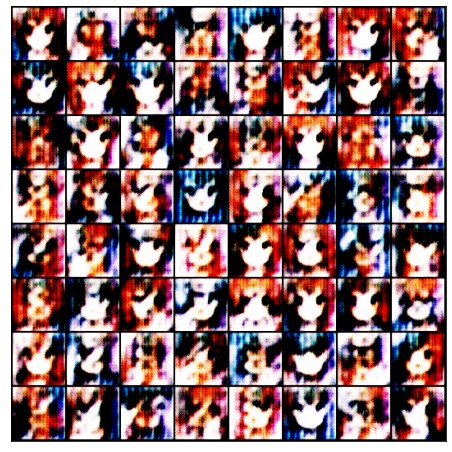

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [2/40], loss_g: 0.4984, loss_d: -0.0741, real_score: 0.3796, fake_score: 0.4537
Saving generated-images-0002.png


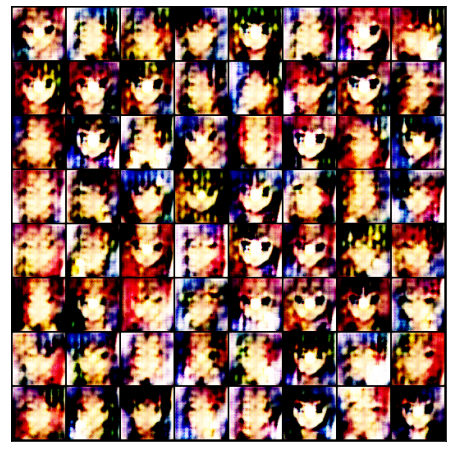

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [3/40], loss_g: 0.5518, loss_d: -0.0761, real_score: 0.3826, fake_score: 0.4587
Saving generated-images-0003.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


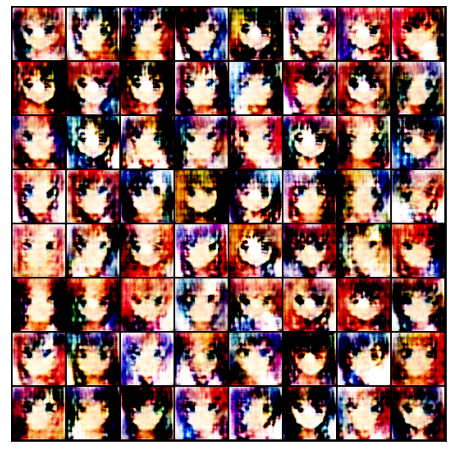

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [4/40], loss_g: 0.6389, loss_d: -0.1648, real_score: 0.4301, fake_score: 0.5949
Saving generated-images-0004.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


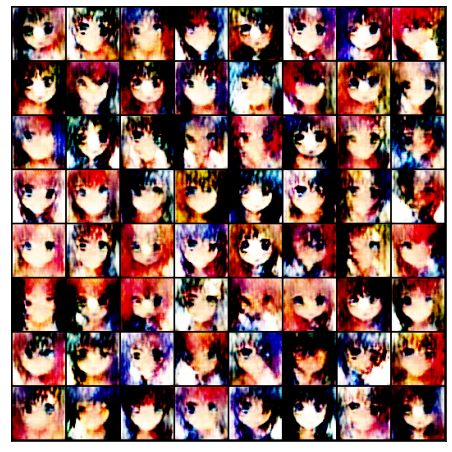

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [5/40], loss_g: 0.5538, loss_d: -0.0872, real_score: 0.3729, fake_score: 0.4601
Saving generated-images-0005.png


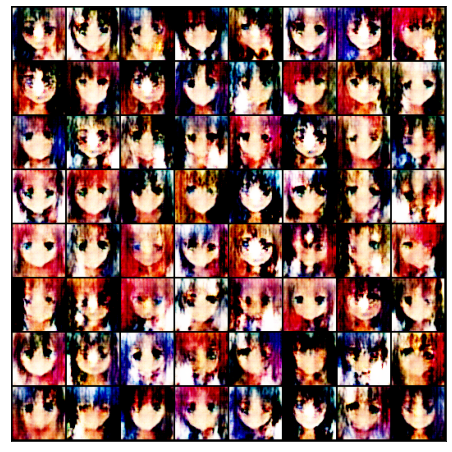

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [6/40], loss_g: 0.6324, loss_d: -0.1418, real_score: 0.4743, fake_score: 0.6161
Saving generated-images-0006.png


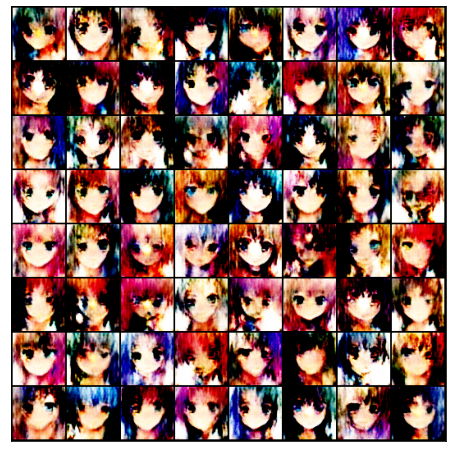

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [7/40], loss_g: 0.6450, loss_d: -0.2498, real_score: 0.3653, fake_score: 0.6152
Saving generated-images-0007.png


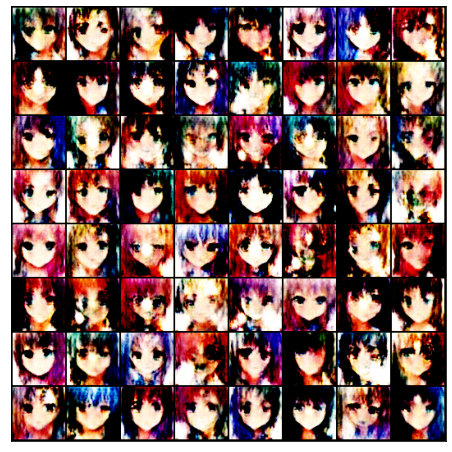

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [8/40], loss_g: 0.6387, loss_d: -0.1886, real_score: 0.4157, fake_score: 0.6043
Saving generated-images-0008.png


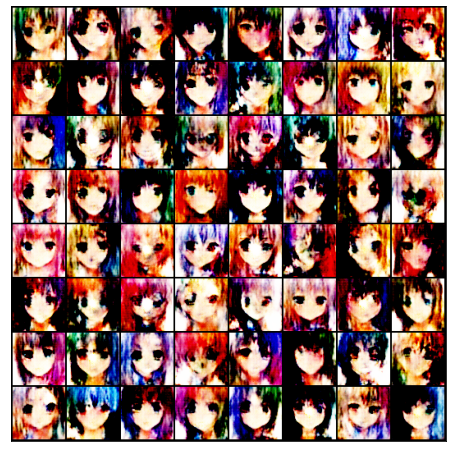

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [9/40], loss_g: 0.6382, loss_d: -0.1384, real_score: 0.4719, fake_score: 0.6103


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving generated-images-0009.png


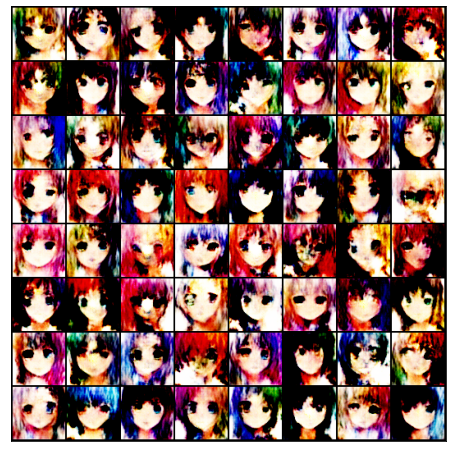

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [10/40], loss_g: 0.5299, loss_d: -0.1212, real_score: 0.3781, fake_score: 0.4993
Saving generated-images-0010.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


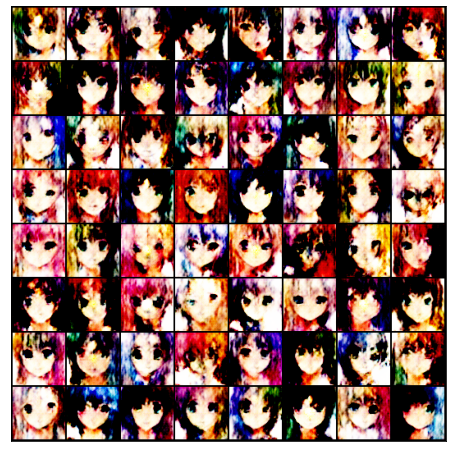

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [11/40], loss_g: 0.6408, loss_d: -0.0930, real_score: 0.5352, fake_score: 0.6282
Saving generated-images-0011.png


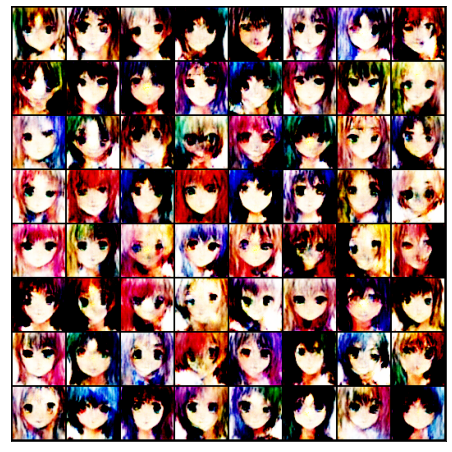

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [12/40], loss_g: 0.6370, loss_d: -0.1402, real_score: 0.4666, fake_score: 0.6068
Saving generated-images-0012.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


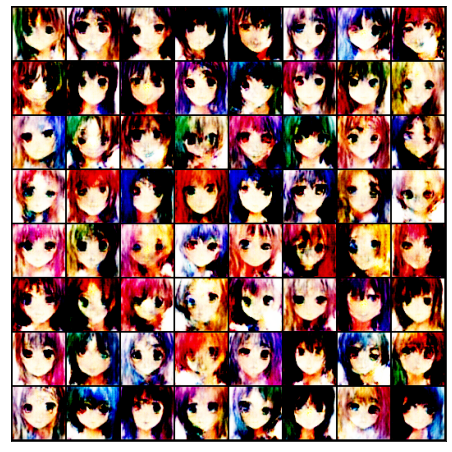

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [13/40], loss_g: 0.5385, loss_d: -0.1360, real_score: 0.3709, fake_score: 0.5069
Saving generated-images-0013.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


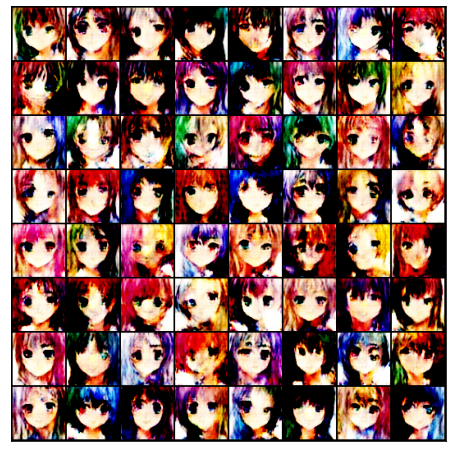

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [14/40], loss_g: 0.6288, loss_d: -0.1504, real_score: 0.4447, fake_score: 0.5951


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving generated-images-0014.png


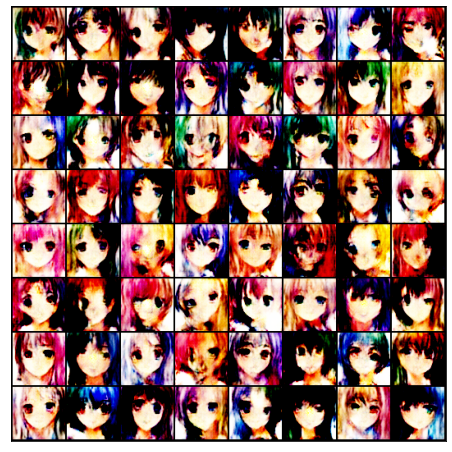

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [15/40], loss_g: 0.6396, loss_d: -0.1170, real_score: 0.5110, fake_score: 0.6280
Saving generated-images-0015.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


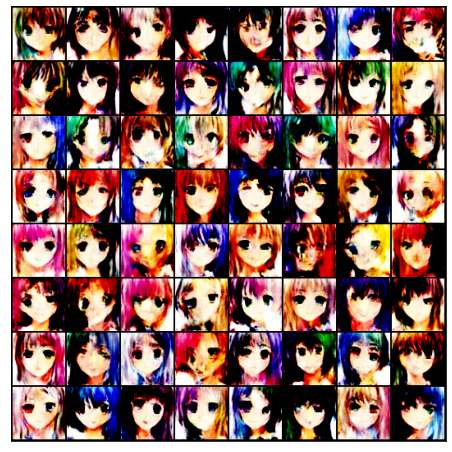

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [16/40], loss_g: 0.6350, loss_d: -0.1853, real_score: 0.4172, fake_score: 0.6025
Saving generated-images-0016.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


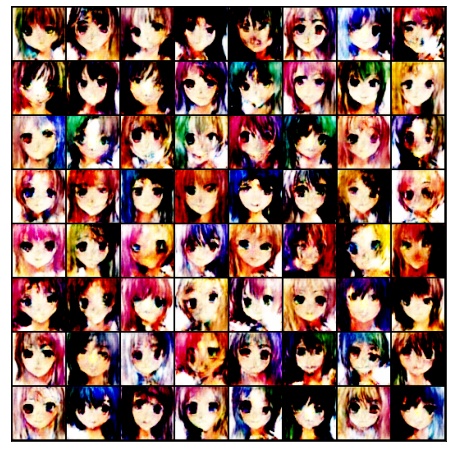

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [17/40], loss_g: 0.6340, loss_d: -0.1700, real_score: 0.3934, fake_score: 0.5635
Saving generated-images-0017.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


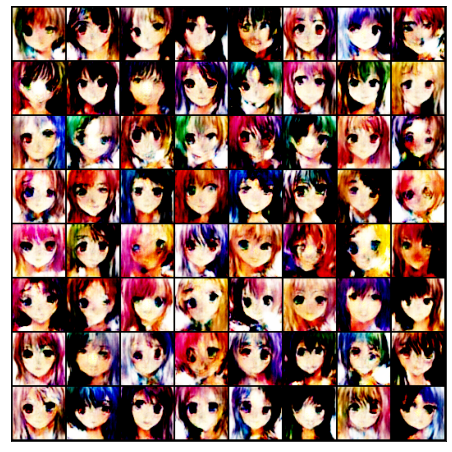

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [18/40], loss_g: 0.6352, loss_d: -0.1726, real_score: 0.4249, fake_score: 0.5974
Saving generated-images-0018.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


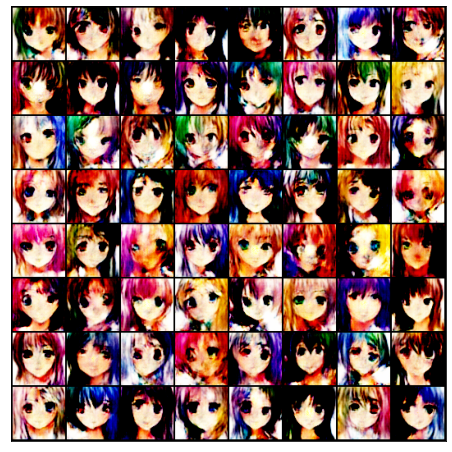

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [19/40], loss_g: 0.5360, loss_d: -0.0671, real_score: 0.3775, fake_score: 0.4446
Saving generated-images-0019.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


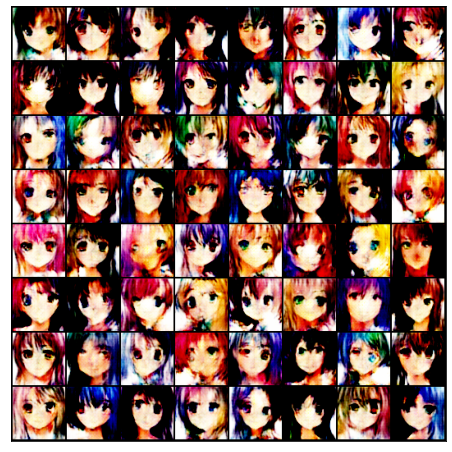

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [20/40], loss_g: 0.5002, loss_d: -0.1652, real_score: 0.3667, fake_score: 0.5319
Saving generated-images-0020.png


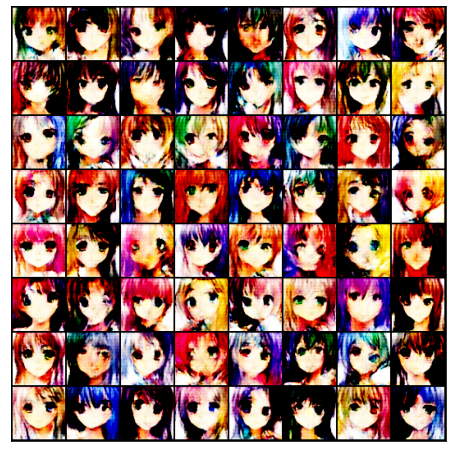

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [21/40], loss_g: 0.5102, loss_d: -0.0851, real_score: 0.3702, fake_score: 0.4553
Saving generated-images-0021.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


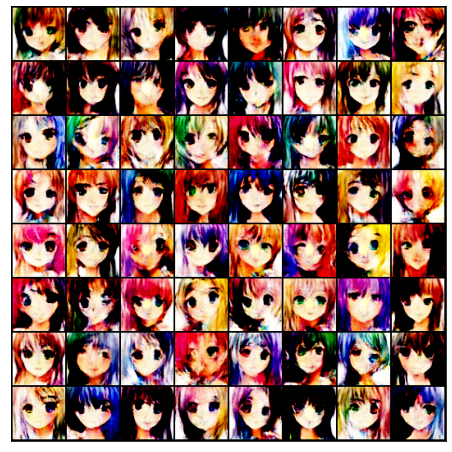

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [22/40], loss_g: 0.6289, loss_d: -0.1117, real_score: 0.4985, fake_score: 0.6102
Saving generated-images-0022.png


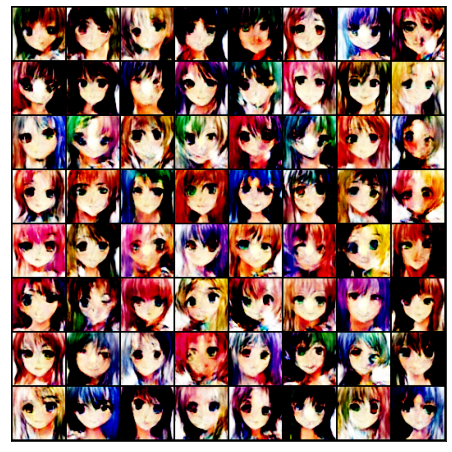

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [23/40], loss_g: 0.6386, loss_d: -0.1261, real_score: 0.4923, fake_score: 0.6184
Saving generated-images-0023.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


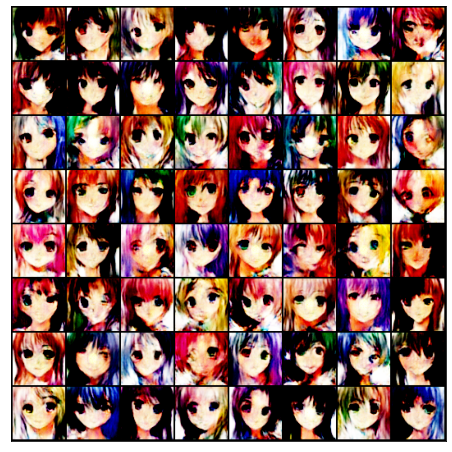

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [24/40], loss_g: 0.5188, loss_d: -0.0900, real_score: 0.3860, fake_score: 0.4760
Saving generated-images-0024.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


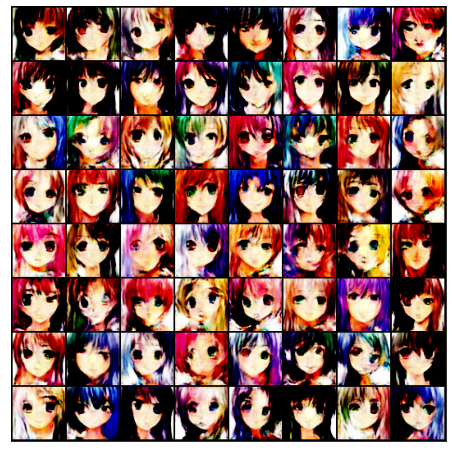

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [25/40], loss_g: 0.6241, loss_d: -0.1338, real_score: 0.4597, fake_score: 0.5935
Saving generated-images-0025.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


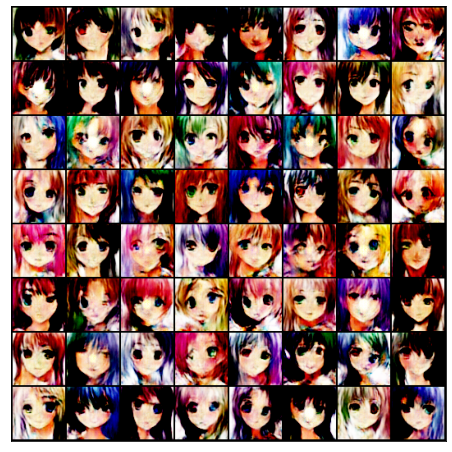

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [26/40], loss_g: 0.6296, loss_d: -0.1491, real_score: 0.4544, fake_score: 0.6034
Saving generated-images-0026.png


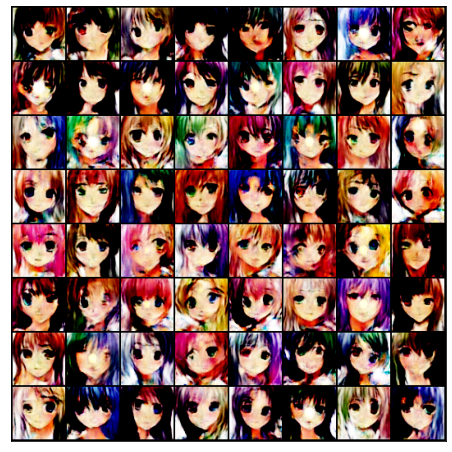

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [27/40], loss_g: 0.6281, loss_d: -0.1335, real_score: 0.4540, fake_score: 0.5875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Saving generated-images-0027.png


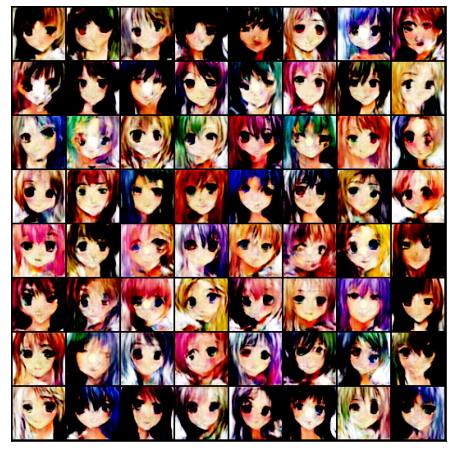

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [28/40], loss_g: 0.5512, loss_d: -0.1207, real_score: 0.3914, fake_score: 0.5120
Saving generated-images-0028.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


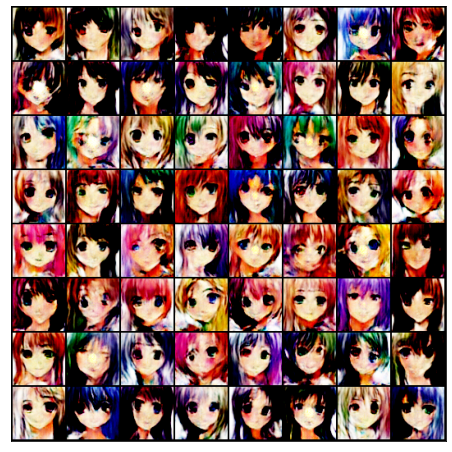

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [29/40], loss_g: 0.6233, loss_d: -0.1055, real_score: 0.4908, fake_score: 0.5963
Saving generated-images-0029.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


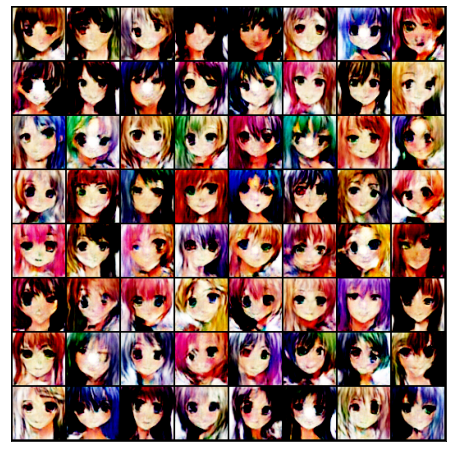

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [30/40], loss_g: 0.5941, loss_d: -0.1358, real_score: 0.4205, fake_score: 0.5563
Saving generated-images-0030.png


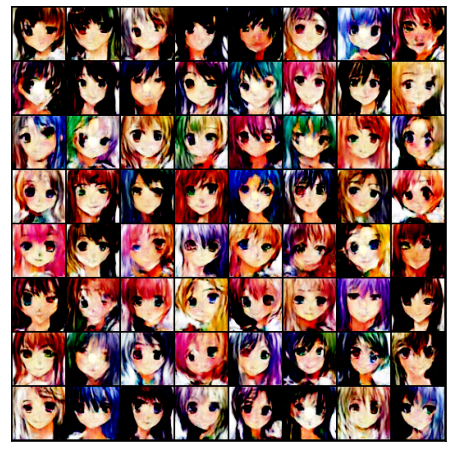

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [31/40], loss_g: 0.5421, loss_d: -0.0742, real_score: 0.3749, fake_score: 0.4492
Saving generated-images-0031.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


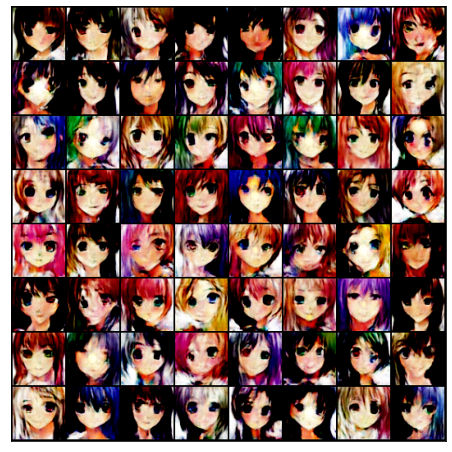

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [32/40], loss_g: 0.6181, loss_d: -0.1204, real_score: 0.4743, fake_score: 0.5947
Saving generated-images-0032.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


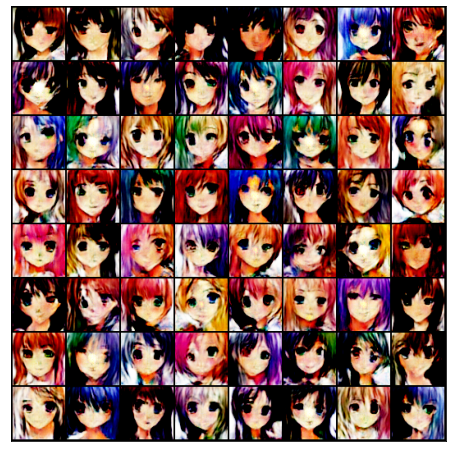

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [33/40], loss_g: 0.4927, loss_d: -0.0635, real_score: 0.3828, fake_score: 0.4463
Saving generated-images-0033.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


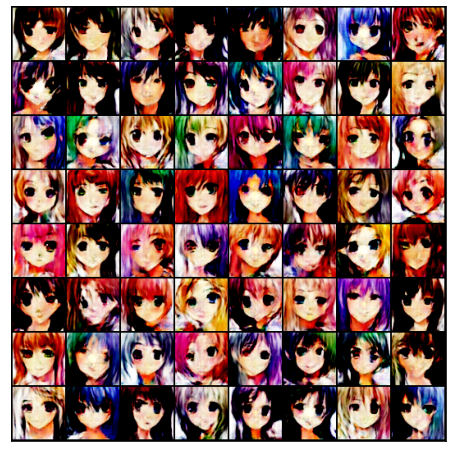

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [34/40], loss_g: 0.5490, loss_d: -0.1360, real_score: 0.3787, fake_score: 0.5147
Saving generated-images-0034.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


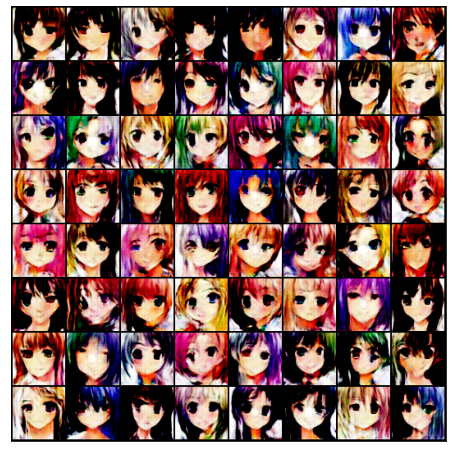

  0%|          | 0/382 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch [35/40], loss_g: 0.5092, loss_d: -0.0896, real_score: 0.3886, fake_score: 0.4782
Saving generated-images-0035.png


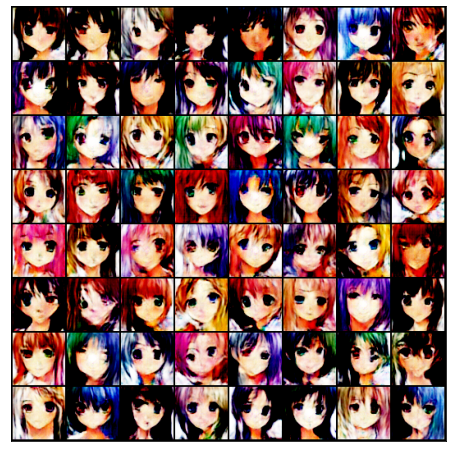

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [36/40], loss_g: 0.5334, loss_d: -0.0985, real_score: 0.3997, fake_score: 0.4981
Saving generated-images-0036.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


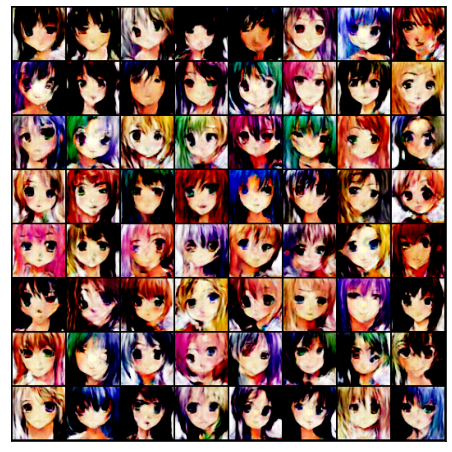

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [37/40], loss_g: 0.6184, loss_d: -0.1252, real_score: 0.4752, fake_score: 0.6005
Saving 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


generated-images-0037.png


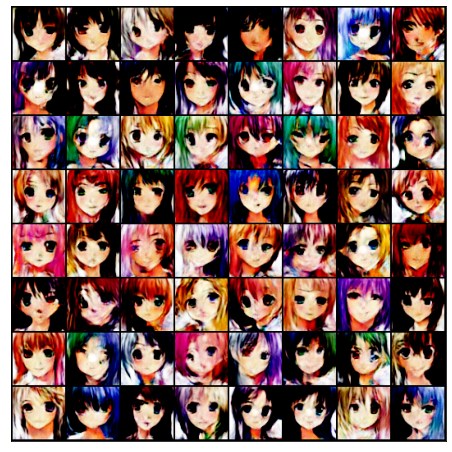

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [38/40], loss_g: 0.5137, loss_d: -0.1032, real_score: 0.3887, fake_score: 0.4919
Saving generated-images-0038.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


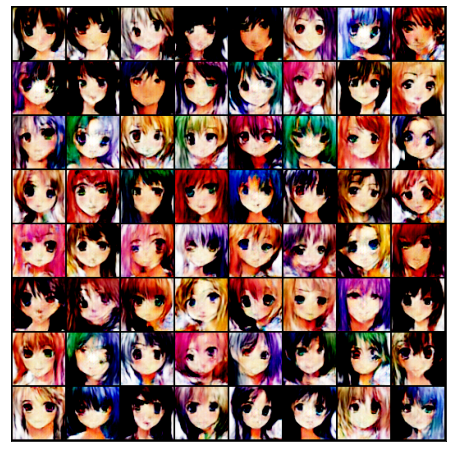

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [39/40], loss_g: 0.6323, loss_d: -0.1062, real_score: 0.5080, fake_score: 0.6142
Saving generated-images-0039.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


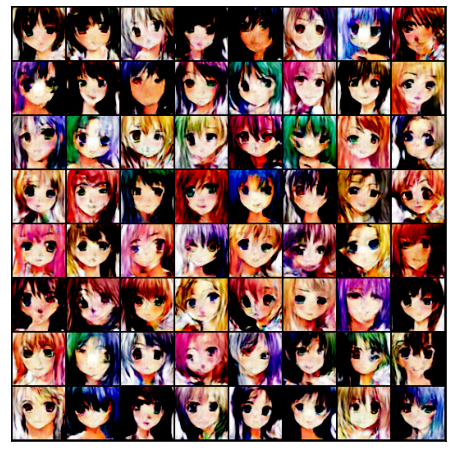

  0%|          | 0/382 [00:00<?, ?it/s]

Epoch [40/40], loss_g: 0.6409, loss_d: -0.2439, real_score: 0.3764, fake_score: 0.6202
Saving generated-images-0040.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


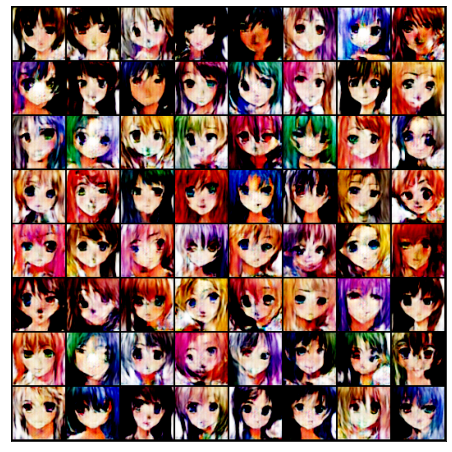

In [10]:
#TODO: Complete the training function
losses_g = []
losses_d = []
real_scores = []
fake_scores = []
def train(D, G, d_optimizer, g_optimizer, epochs=1):
    iter_count = 0
    start_idx=1
    for epoch in range(epochs):
        for i, real_images in enumerate(tqdm(trainloader)):  # Add iteration indexing
            real_images=real_images.to(device)
            # Turn on gradients for discriminator
            for p in D.parameters():
                try:
                    p.requires_grad = True
                except RuntimeError:
                    continue
            d_optimizer.zero_grad()
            # Pass real images through discriminator
            real_outs = D(real_images)
            real_score = real_outs.mean().item()

            # Generate fake images
            noise = torch.randn(batch_size, latent_size, 1, 1).to(device)
            fake_images = G(noise)

            # Pass fake images through discriminator
            d_fake_outs = D(fake_images.detach())
            fake_score = d_fake_outs.mean().item()
            
            # Update discriminator weights
            loss_d = real_outs.mean(0).view(1) - d_fake_outs.mean(0).view(1)  # Wasserstein distance
            loss_d.backward()
            d_optimizer.step()
            
            # Clamp discriminator parameters as described in WGAN article
            for p in D.parameters():
                p.data.clamp_(-0.01, 0.01)
            
            # Train generator only every 5 discriminator training iterations
            if i%5 != 0:
                continue
            
            ## 2. Train the generator with an adversarial loss
            # Generate fake images
            # Turn off discriminator gradients
            for p in D.parameters():
                try:
                    p.requires_grad = False
                except RuntimeError:
                    continue
            g_optimizer.zero_grad()
            fake_images = G(noise)
            
            # Try to fool the discriminator
            g_fake_outs = D(fake_images)
            loss_g = g_fake_outs.mean().mean(0).view(1)  # From WGAN paper
            
            # Update generator weights
            loss_g.backward()
            g_optimizer.step()            
              
        losses_g.append(loss_g.item())
        losses_d.append(loss_d.item())
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        # Log losses & scores (last batch)
        
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
        epoch+1, epochs, loss_g.item(), loss_d.item(), real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent,G, show=True)
            
        state_dis = {'dis_model': D.state_dict(), 'epoch': epoch}
        state_gen = {'gen_model': G.state_dict(), 'epoch': epoch}
        if not os.path.isdir('checkpoint'):
            os.mkdir('checkpoint') 
        torch.save(state_dis, 'checkpoint/'+'D__'+str(epoch+1)) #each epoch
        torch.save(state_gen, 'checkpoint/'+'G__'+str(epoch+1)) #each epoch
#Train the GAN
train(D,G,opt_d,opt_g,epochs=40)

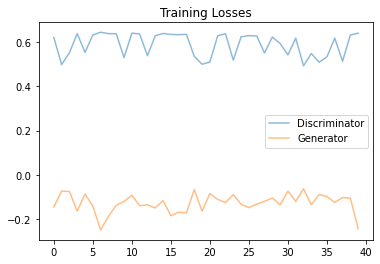

In [11]:
##Visualize your loss curve of D and G
fig, ax = plt.subplots()
plt.plot(losses_g, label='Discriminator', alpha=0.5)
plt.plot(losses_d, label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question1: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result

Answer: I believe that given a longer training time the model would reach an optimal state at some point. However, right now there is still some strange noisy patches and some of the face shapes are slightly warped. 

### Question2: How does the training loss of the generator and the discriminator change during your training?

Answer: It seems that the losses fluctuate quite a lot. In fact, the 40th generation seems to be less optimal than the 39th, but this should improve in the next generation.

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "final_project_StudentNumber_StudentName.ipynb". Include the generated images in your submission.